In [1]:
    #### Basic imports ####
import pandas as pd
import numpy as np
import os

    #### Machine Learning imports ####
from sklearn.cluster import KMeans
from sklearn.preprocessing import Normalizer, StandardScaler, RobustScaler, OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer, make_column_selector

    ## evaluate model ##
from sklearn import metrics

    #### Data vizualisation ####
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from yellowbrick.cluster import KElbowVisualizer
from pandas.plotting import parallel_coordinates

In [2]:
path='../data/'
X = pd.read_csv(os.path.join(path,'X_full.csv'))

In [3]:
categorical_columns = ['client_id','client_type','zipcode']
numerical_columns = [col for col in X.columns if col not in categorical_columns]

# Check for outliers

<AxesSubplot:xlabel='total_amount_per_client', ylabel='Count'>

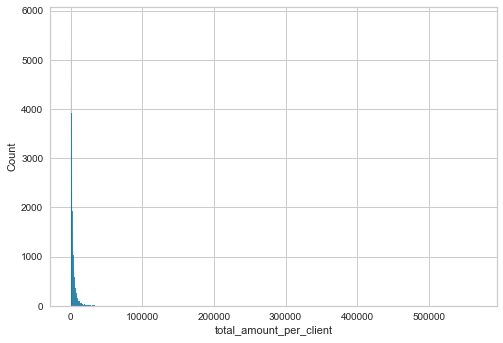

In [5]:
sns.histplot(X["total_amount_per_client"])

In [6]:
# Check for the outliers
print(f'Percentage of amount spend > 10_000€ : \n{round(len(X[X["total_amount_per_client"] >= 10_000])/len(X)*100,2)}%')
print(f'Percentage of amount spend < 50€ : \n{round(len(X[X["total_amount_per_client"] <= 50])/len(X)*100,2)}%') 

Percentage of amount spend > 10_000€ : 
5.44%
Percentage of amount spend < 50€ : 
1.54%


In [7]:
X = X[X['total_amount_per_client'].between(50,10_000)]

#  Moment of the day

## Data prep

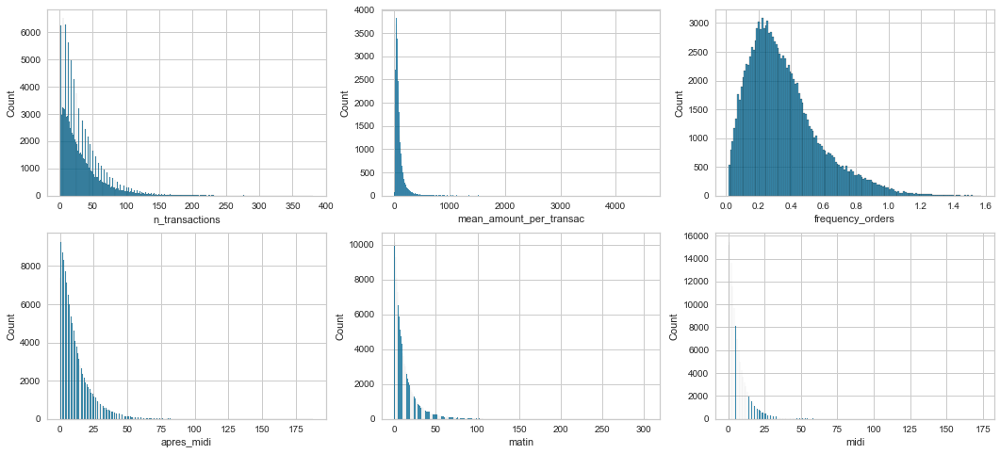

In [19]:
features_mod = ['n_transactions','mean_amount_per_transac','frequency_orders', 'apres_midi', 'matin', 'midi', 'soir','lundi', 'mardi', 'mercredi', 'jeudi', 'vendredi',
       'samedi', 'dimanche']
X_mod = X[features_mod]

fig, axs = plt.subplots(2,3,figsize=(18,8))
for col,ax in zip(list(X_mod.columns),axs.ravel()):
    sns.histplot(X_mod[col],ax=ax)

In [20]:
# Check for the outliers
print(f'Percentage of afternoon transactions > 150 : \n{round(len(X_mod[X_mod["apres_midi"] >= 150])/len(X_mod)*100,2)}%')
print(f'Percentage of matin transactions > 150 : \n{round(len(X_mod[X_mod["matin"] >= 150])/len(X_mod)*100,2)}%')
print(f'Percentage of midi transactions > 150 : \n{round(len(X_mod[X_mod["midi"] >= 150])/len(X_mod)*100,2)}%')
print(f'Percentage of soir transactions > 150 : \n{round(len(X_mod[X_mod["soir"] >= 150])/len(X_mod)*100,2)}%')


Percentage of afternoon transactions > 150 : 
0.01%
Percentage of matin transactions > 150 : 
0.06%
Percentage of midi transactions > 150 : 
0.0%
Percentage of soir transactions > 150 : 
0.0%


In [21]:
X_mod = X_mod[X_mod['apres_midi'].between(0,150)]
X_mod = X_mod[X_mod['midi'].between(0,150)]
X_mod = X_mod[X_mod['matin'].between(0,150)]
X_mod = X_mod[X_mod['soir'].between(0,150)]

## Pipelines

### Preprocess

In [23]:
#prepare tranformer for numerical values
num_col = make_column_selector(dtype_include=['float64','int64'])
num_transformer = Pipeline([('scaler',Normalizer())])

#prepare transformer for categorical values
#cat_transformer = OneHotEncoder(handle_unknown='ignore')

preprocessor = ColumnTransformer([
                ('num_trans',num_transformer,num_col),
                #('cat_trans',cat_transformer,categorical_columns)
                                ],
                remainder='drop')

X_mod_prep = preprocessor.fit_transform(X_mod)

### Model

#### Choose the best k

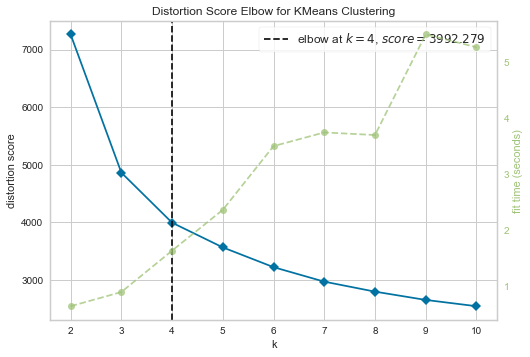

In [24]:
kmeans = KMeans(init='k-means++', 
                max_iter=500, 
                random_state=42)
elbow_visualizer = KElbowVisualizer(kmeans, n_clusters = (1,11))
elbow_visualizer.fit(X_mod_prep)
elbow_visualizer.show();

#### Pipeline with choosen cluster

In [25]:
model_pipe_mod = Pipeline([
                ('preprocessing', preprocessor),
                ('model',KMeans(n_clusters = 6, 
                                init='k-means++', 
                                max_iter=500, 
                                random_state=42,
                               ))
                       ])

kmeans_mod = model_pipe_mod.fit(X_mod)
labels_mod = model_pipe_mod['model'].labels_

### Evaluate model

#### Vizualisation

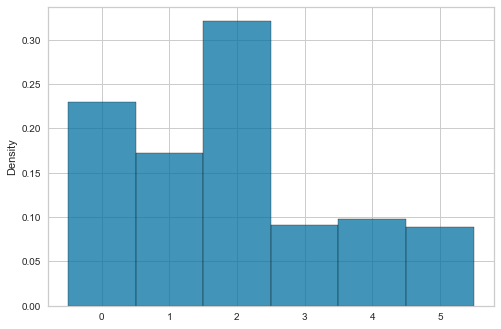

In [26]:
sns.histplot(labels_mod, discrete=True, stat='density');

In [27]:
X_mod['labels'] = labels_mod

In [28]:
px.scatter_3d(X_mod_prep,
               x = 1, 
               y = 2,
               z = 3,
               color = labels_mod,
                labels={
                 "1": "total amount",
                 "2": "frequency_orders",
                 "3": "afternoon",
                 "labels_rfm": "client_cluster"})

<AxesSubplot:>

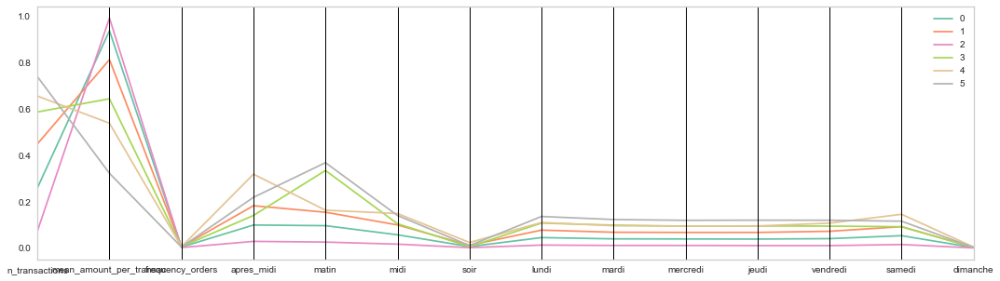

In [29]:
# Create a data frame containing our centroids
centroids = pd.DataFrame(model_pipe_mod['model'].cluster_centers_, columns=features_mod, index=[i for i in range(6)])
centroids['cluster'] = centroids.index

plt.figure(figsize=(18,5))
parallel_coordinates(centroids, 'cluster', colormap=plt.get_cmap("Set2"))


#### Silhouette Score

In [30]:
metrics.silhouette_score(X_mod_prep, labels_mod, metric='euclidean')

0.3342230101679384

# Results interpretation

## Time of day features

## Next steps :